In [1]:
%load_ext autoreload

%autoreload 2

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [3]:
from sdclane import config, utility, camera, line_detection

In [4]:
test_imgs = utility.read_rgb_imgs(config.test_img_files)

## test camera calibration on test images

In [5]:
undistort = camera.build_undistort_function()

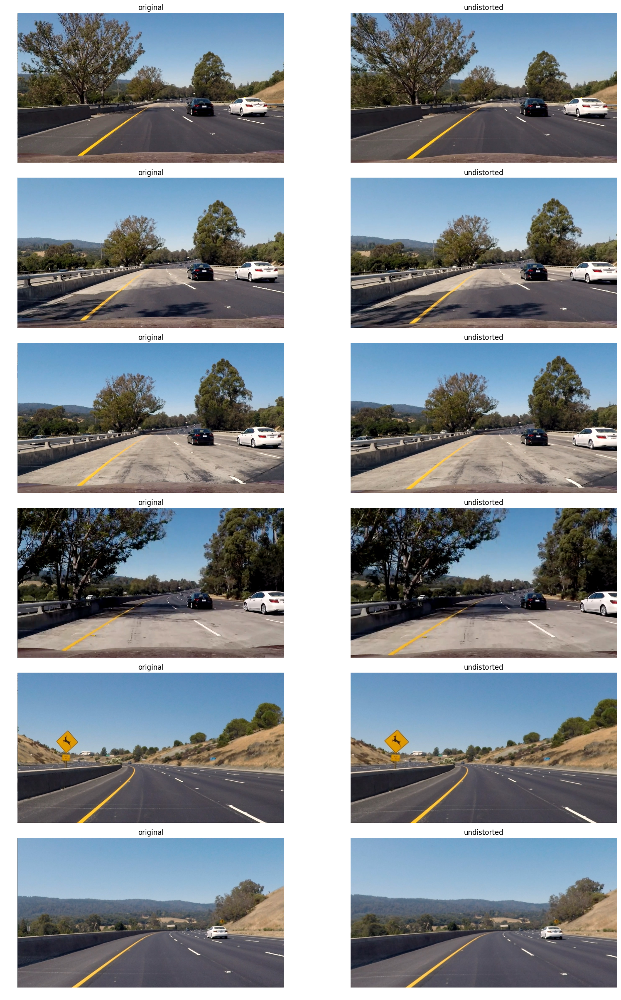

In [6]:
fig, axes = plt.subplots(6, 2, figsize = (8*2, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, test_img in zip(axes, test_imgs):
    ax[0].imshow(test_img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    undist = undistort(test_img)
    ax[1].imshow(undist)
    ax[1].set_title("undistorted")
    ax[1].set_axis_off()

## test line detection pipeline

In [7]:
detect_lines = line_detection.build_default_detect_lines_function()

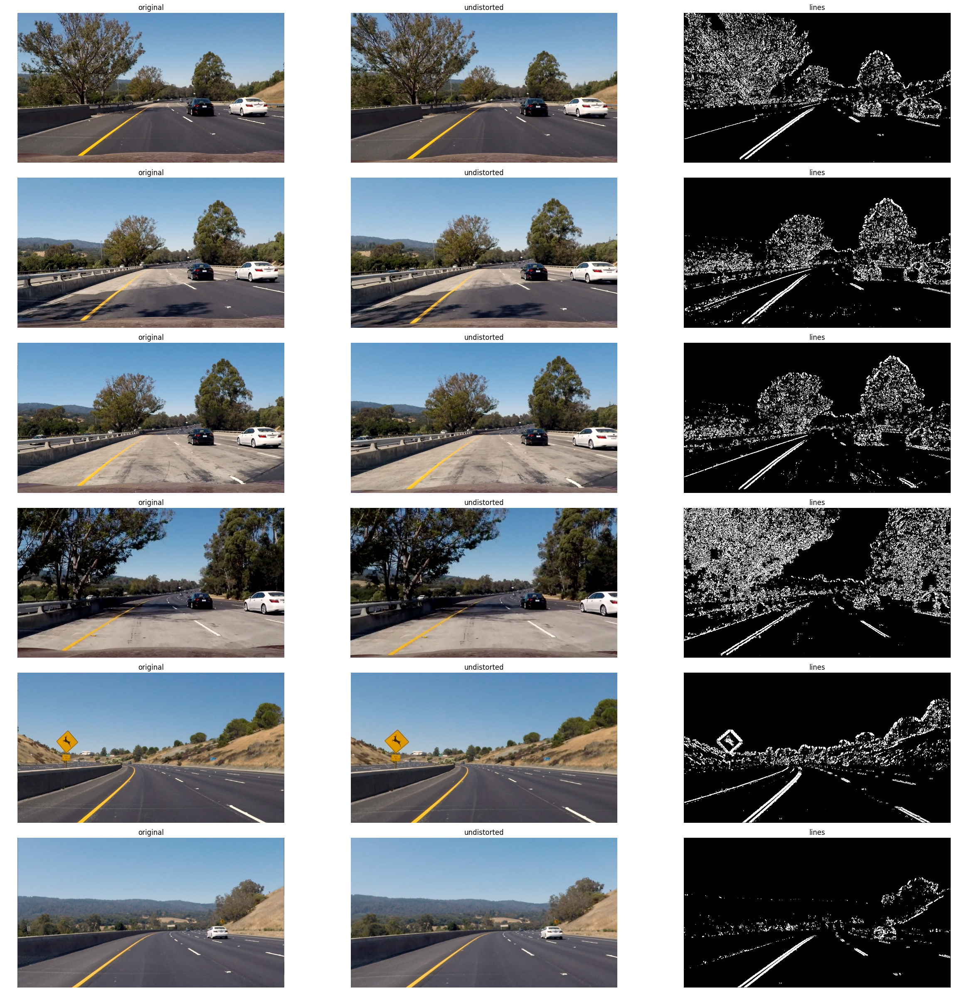

In [8]:
fig, axes = plt.subplots(6, 3, figsize = (8*3, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, test_img in zip(axes, test_imgs):
    ax[0].imshow(test_img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    test_img = undistort(test_img)
    ax[1].imshow(test_img)
    ax[1].set_title("undistorted")
    ax[1].set_axis_off()
    
    lines = detect_lines(test_img)
    ax[2].imshow(lines, cmap=plt.cm.gray)
    ax[2].set_title("lines")
    ax[2].set_axis_off()

## test perspective transform

In [10]:
from sdclane.transform import build_trapezoidal_bottom_roi_crop_function
from sdclane.transform import build_default_warp_transformer

roi_crop = build_trapezoidal_bottom_roi_crop_function()
detect_roi_lines = utility.make_pipeline([undistort, detect_lines])#, roi_crop])
transformer = build_default_warp_transformer()

/root/anaconda3/lib/python3.5/site-packages/skimage/measure/fit.py:57: skimage_deprecation: `LineModel` is deprecated, use `LineModelND` instead.
  warn(skimage_deprecation('`LineModel` is deprecated, '


In [12]:
print(transformer.x_mpp, transformer.y_mpp)

0.00302229618077 0.018273805876399554


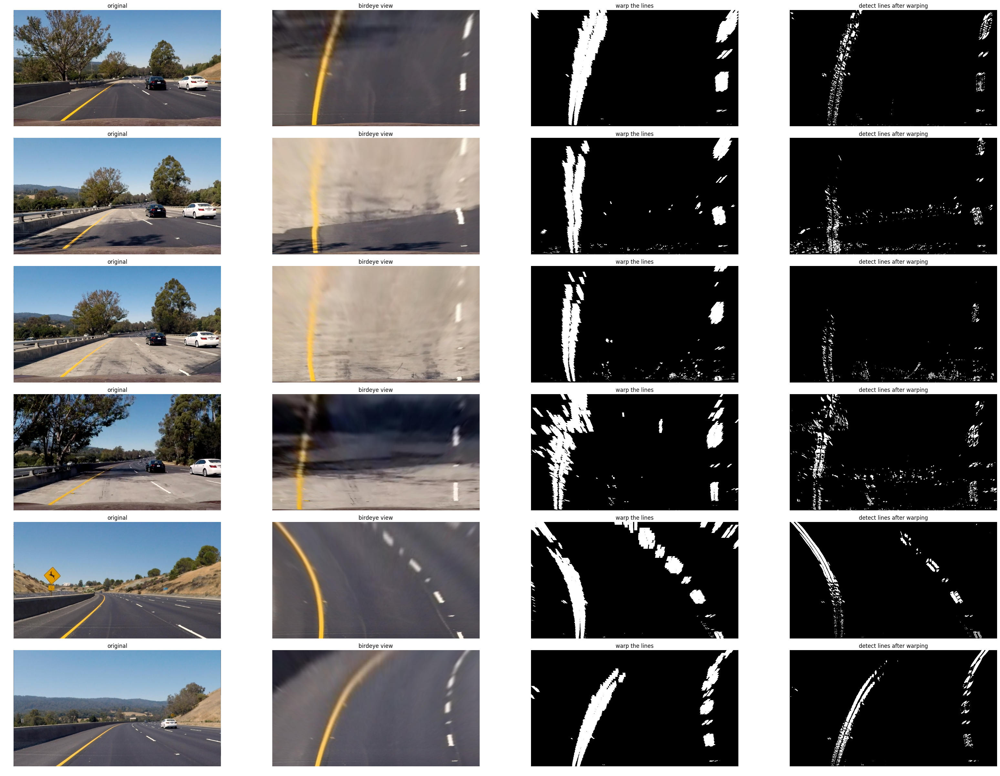

In [13]:
fig, axes = plt.subplots(6, 4, figsize = (8*4, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, img in zip(axes, test_imgs):
    ax[0].imshow(img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    warped_img = transformer.transform(undistort(img))
    ax[1].imshow(warped_img)
    ax[1].set_title("birdeye view")
    ax[1].set_axis_off()
    
#     line_img = line_detector(warped_img)
    line_img = transformer.binary_transform(detect_roi_lines(img))
    ax[2].imshow(line_img, cmap=plt.cm.gray)
    ax[2].set_title("warp the lines")
    ax[2].set_axis_off()
    
    line_img = detect_lines(warped_img)
    ax[3].imshow(line_img, cmap=plt.cm.gray)
    ax[3].set_title("detect lines after warping")
    ax[3].set_axis_off()

/root/anaconda3/lib/python3.5/site-packages/skimage/measure/fit.py:57: skimage_deprecation: `LineModel` is deprecated, use `LineModelND` instead.
  warn(skimage_deprecation('`LineModel` is deprecated, '


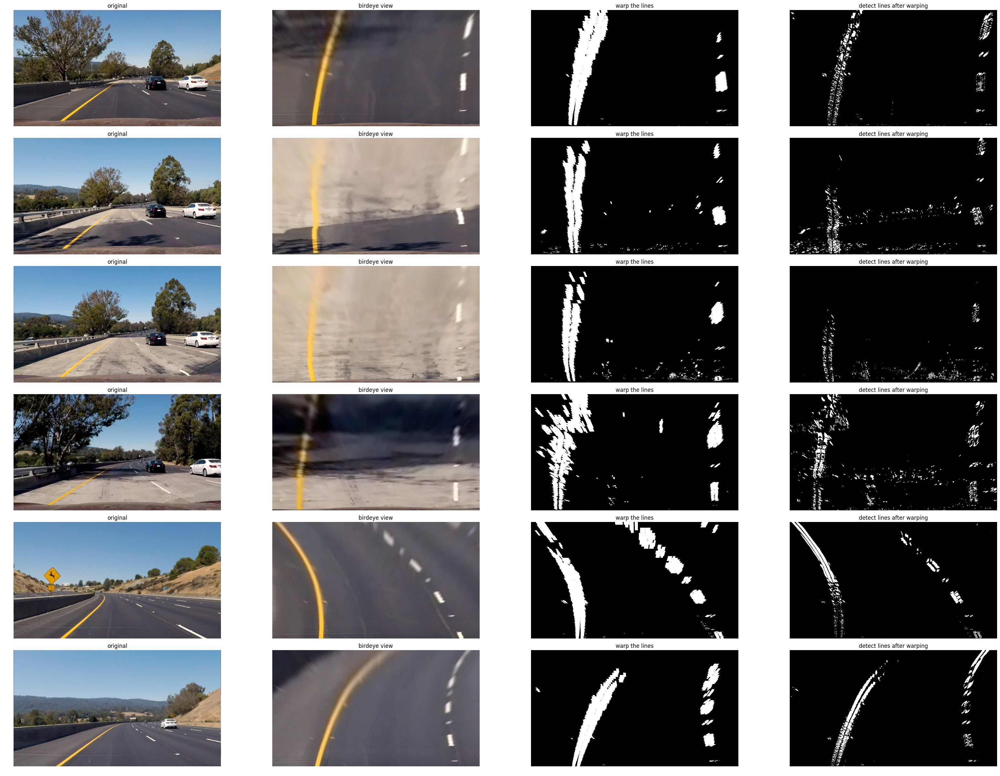

In [187]:
from sdclane.transform import build_trapezoidal_bottom_roi_crop_function
from sdclane.transform import build_default_warp_transformer

roi_crop = build_trapezoidal_bottom_roi_crop_function()
detect_roi_lines = utility.make_pipeline([undistort, detect_lines, roi_crop])
transformer = build_default_warp_transformer()

line_imgs = []

fig, axes = plt.subplots(6, 4, figsize = (8*4, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, img in zip(axes, test_imgs):
    ax[0].imshow(img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    warped_img = transformer.transform(undistort(img))
    ax[1].imshow(warped_img)
    ax[1].set_title("birdeye view")
    ax[1].set_axis_off()
    
#     line_img = line_detector(warped_img)
    line_img = transformer.binary_transform(detect_roi_lines(img))
    ax[2].imshow(line_img, cmap=plt.cm.gray)
    ax[2].set_title("warp the lines")
    ax[2].set_axis_off()
    
    line_img = detect_lines(warped_img)
    line_imgs.append(line_img)
    ax[3].imshow(line_img, cmap=plt.cm.gray)
    ax[3].set_title("detect lines after warping")
    ax[3].set_axis_off()

## Lane Detector

In [24]:
from sdclane.lane_detection import LaneDetector

In [25]:
lane_detector = LaneDetector()

/root/anaconda3/lib/python3.5/site-packages/skimage/measure/fit.py:57: skimage_deprecation: `LineModel` is deprecated, use `LineModelND` instead.
  warn(skimage_deprecation('`LineModel` is deprecated, '


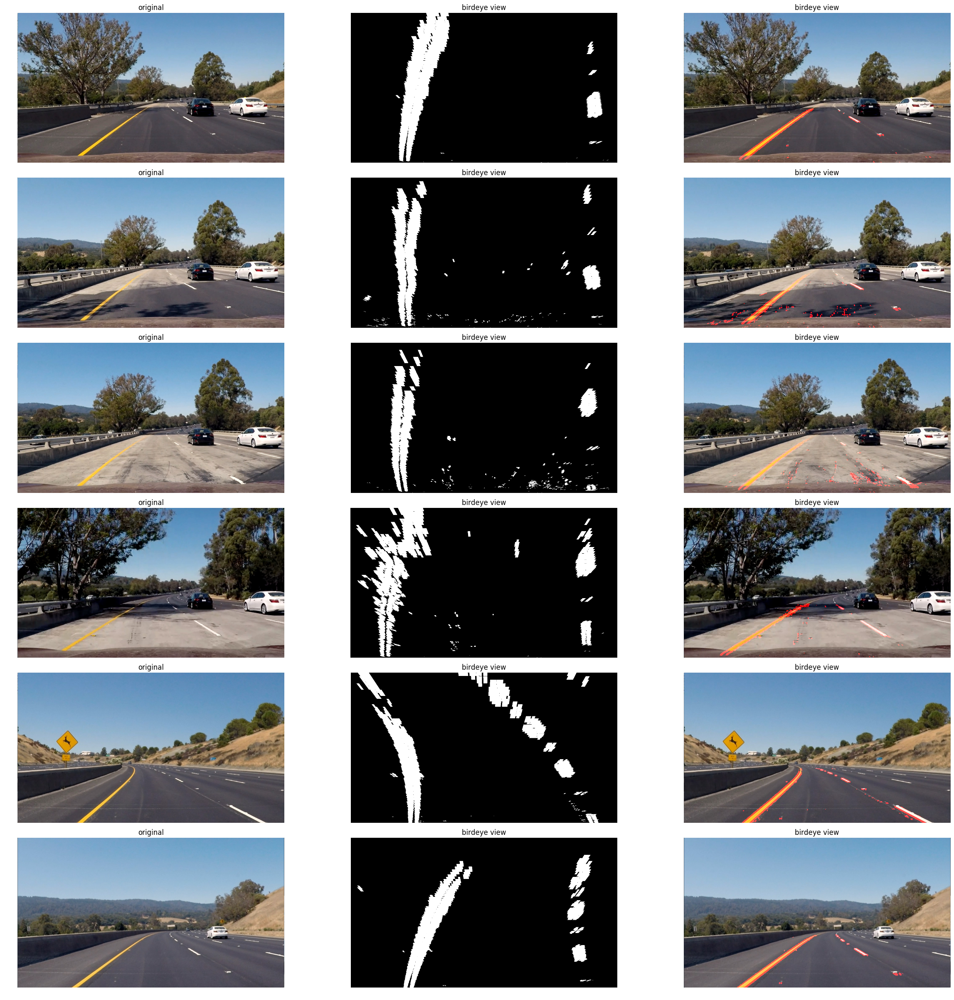

In [512]:
fig, axes = plt.subplots(6, 3, figsize = (8*3, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )

lane_imgs = []
for ax, img in zip(axes, test_imgs):
    ax[0].imshow(img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    lane_img = lane_detector.detect_lane(img)
    lane_imgs.append(lane_img)
    ax[1].imshow(lane_img, cmap=plt.cm.gray)
    ax[1].set_title("birdeye view")
    ax[1].set_axis_off()
    
    inversed_lane_img = lane_detector.transformer.binary_transform(lane_img, inverse=True)
    zeros = np.zeros_like(inversed_lane_img)
    inversed_lane_img = np.dstack([inversed_lane_img*255, zeros, zeros]).astype(np.uint8)
    combined = cv2.addWeighted(img, 1, inversed_lane_img, 1, 0)
    ax[2].imshow(combined)
    ax[2].set_title("birdeye view")
    ax[2].set_axis_off()
    

In [547]:
from skimage.morphology import remove_small_objects

def estimate_lane(lane_img):
    """Estimates curvature and center
    of lane.
    `lane_img`: bool image with lane boundaries marked
    """
    H, W = lane_img.shape[:2]
    lane_img = remove_small_objects(lane_img.copy())
    window, stride = 100, 1
    lxs, lys = [], [] # lane left boundary coordinates
    mxs, mys = [], [] # lane middle coordinates
    rxs, rys = [], [] # lane right boundary coordinates
    for offset in range(0, H+1, stride):
        region = lane_img[offset:offset+window, :]
        ys, xs = np.where(region > 0)
        is_valid_region = (len(xs) > 0) and (W/3 <= (xs.max()-xs.min()) <= W*5/6)
        if is_valid_region:
            mx = (np.min(xs) + np.max(xs))/2
            my = np.mean(ys) + offset
            lx = np.min(xs)
            ly = my
            rx = np.max(xs)
            ry = my
            if len(mxs) == 0 or np.abs(mx - np.mean(mxs)) <= 100:
                mxs.append(mx)
                mys.append(my)
                lxs.append(lx)
                lys.append(ly)
                rxs.append(rx)
                rys.append(ry)

    lxs,lys,mxs,mys,rxs,rys = map(np.array, [lxs,lys,mxs,mys,rxs,rys])
    lmodel = np.polyfit(lys, lxs, 2)
    mmodel = np.polyfit(mys, mxs, 2)
    rmodel = np.polyfit(lys, lxs, 2)
    return lxs, lys, mxs, mys, rxs, rys, lmodel, mmodel, rmodel

In [548]:
_ = estimate_lane(lane_imgs[0])

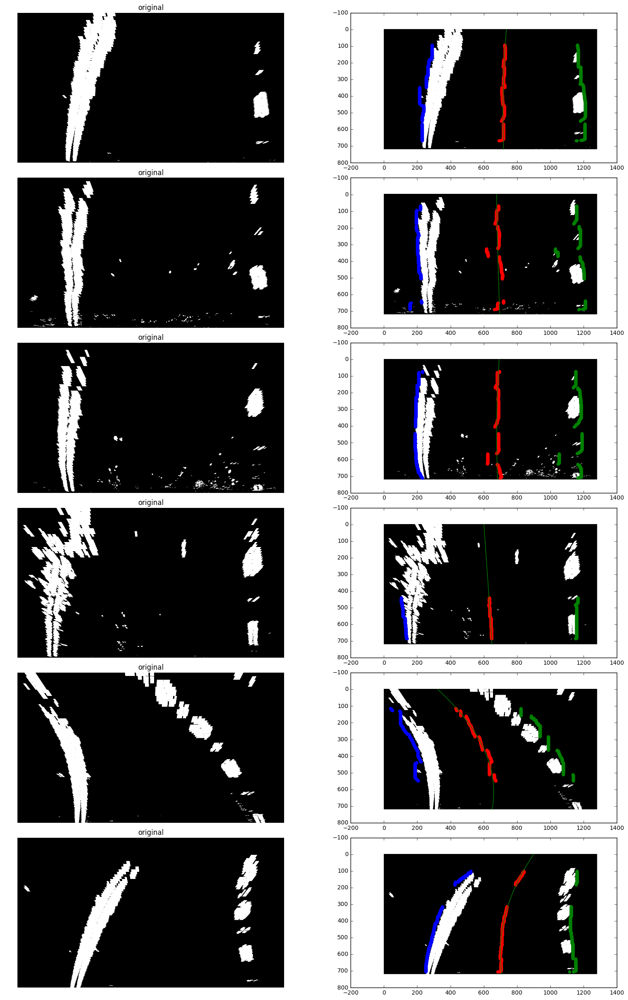

In [550]:
fig, axes = plt.subplots(6, 2, figsize = (8*2, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )


for ax, lane_img in zip(axes, lane_imgs):
    ax[0].imshow(lane_img, cmap=plt.cm.gray)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    
    lxs, lys, mxs, mys, rxs, rys, lmodel, mmodel, rmodel = estimate_lane(lane_img)
    ax[1].imshow(lane_img, cmap=plt.cm.gray)
    ax[1].scatter(mxs, mys, marker="o", color="red")
    ax[1].scatter(lxs, lys, marker="o", color="blue")
    ax[1].scatter(rxs, rys, marker="o", color="green")

    y_span = range(0, lane_img.shape[0])
    mxhat = np.polyval(mmodel, y_span)
    ax[1].plot(mxhat, y_span, "g-")

In [475]:
window, stride = 50, 1
mxs, mys = [], [] # middle line coordinates
for offset in range(0, lane_img.shape[0], stride):
    region = lane_img[offset:offset+window, :]
    rys, rxs = np.where(region > 0)
    if len(rxs) > 0 and (rxs.max()-rxs.min())>=lane_img.shape[1]/2 and (rxs.max()-rxs.min())<=lane_img.shape[1]*2/3:
        rx = (np.min(rxs) + np.max(rxs))/2
        ry = np.mean(rys) + offset
        if len(mxs) == 0 or np.abs(rx - np.mean(mxs)) <= 100:
            mxs.append(rx)
            mys.append(ry)
        
mxs = np.array(mxs)
mys = np.array(mys)

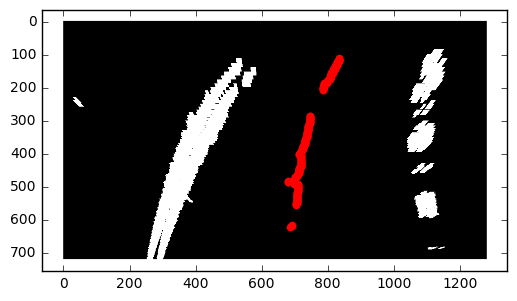

In [476]:
plt.imshow(lane_img, cmap=plt.cm.gray)
plt.scatter(mxs, mys, marker="o", color="red")

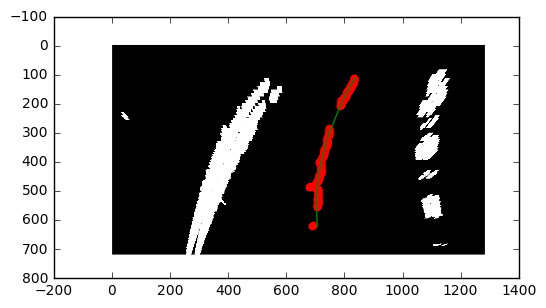

In [477]:
poly_model = np.polyfit(mys, mxs, 2)
plt.imshow(lane_img, cmap=plt.cm.gray)
plt.scatter(mxs, mys, marker="o", color="red")

xhat = np.polyval(poly_model, sorted(mys))
plt.plot(xhat, sorted(mys), "g-")

In [447]:
# from sklearn.cluster import KMeans
# ys, xs = np.where(lane_img > 0)
# xs, ys = xs.astype(np.float32), ys.astype(np.float32)
# cluster2 = KMeans(2).fit(np.c_[xs, ys])


In [299]:
# from sklearn.cluster import Birch
# ys, xs = np.where(lane_img > 0)
# xs, ys = xs.astype(np.float32), ys.astype(np.float32)
# cluster2 = Birch(2).fit(np.c_[xs, ys])